# Image Compression

For an 8 megapixel camera, the raw size of an image woudl be 8 millions pixels times 3 color channels (red-green-blue or RGB) times 8-bits (or 1 byte) to represent each color-channel.
Overall this would result in a file size of 24 Megabytes. However if you check the images you take with your cell-phone the actual file-size is much smaller than that (around 10% of the raw image size).
That's because the image is compressed prior to storage. One of the most popular compression techniques is JPEG.

Frequency domain transforms have the advantage of sparsely representing data.This means that for a high dimensional signal of length $n$, by converting it to the frequency domain we need $d \ll n $ elements to represent most of the information in a signal.
One of the most extreme examples are a sinusoid of length $n$ and frequency $f_0$ which in the DFT domain has only $2 \ll n $ non-zero elements. 

In this project, I will implement a modified version of the JPEG image compression algorithm. JPEG is a **lossy** image compression algorithm relying on a frequency domain transform called DCT. By reducing or removing high-frequency information, the image can be represented using  a significantly smaller number of elements than $n_{rows} \times n_{columns}$ pixels. Image compression (and signal compression in general) is important for efficient data storage and sharing.   
Note that the actual implementation of JPEG differs from the implementation below and relies on coding theory which we have not covered in the course.

## 0) Background: The Discrete Cosine Transform (DCT)

We begin with defining the DCT and inverse DCT two-dimensional transforms (scipy only implements the 1D version of the DCT).  
The DCT as opposed to the DFT is a real-valued transform based on cosines and given by 
$$ D[u,v]=\alpha_{u}\alpha_{v} \sum_{m=0}^{M-1}\sum_{n=0}^{N-1}I[m,n]\cos(\frac{\pi(2m+1)u}{2M})\cos(\frac{\pi(2n+1)v}{2N}),$$ where $0\leq u \leq M-1,\quad 0 \leq v \leq N-1$ and 
$$ \alpha_u =  \begin{cases} 
1/\sqrt{M},\quad u=0 \\
\sqrt{2/M}, \quad  1\leq u \leq M-1
\end{cases} $$ and
$$ \alpha_v =  \begin{cases} 
1/\sqrt{N},\quad v=0 \\
\sqrt{2/N}, \quad  1\leq v \leq N-1
\end{cases}. $$  
Note that this is still a frequency-based transformation of the data, however as opposed to the DFT its basis funcitons are real cosine signals of increasing frequency, as opposed to the complex exponential basis fucntions of the DFT.

The inverse transform, IDCT, in 2D is given by 
$$ I[m,n]=\sum_{u=0}^{M-1}\sum_{v=0}^{N-1} \alpha_{u}\alpha_{v} D[u,v]\cos(\frac{\pi(2m+1)u}{2M})\cos(\frac{\pi(2n+1)v}{2N}),$$ where $0\leq m \leq M-1,\quad 0 \leq n \leq N-1$ and 
$$ \alpha_u =  \begin{cases} 
1/\sqrt{M},\quad u=0 \\
\sqrt{2/M}, \quad  1\leq u \leq M-1
\end{cases} $$ and
$$ \alpha_v =  \begin{cases} 
1/\sqrt{N},\quad v=0 \\
\sqrt{2/N}, \quad  1\leq v \leq N-1
\end{cases}. $$  

We define 2 functions applying the 2D DCT and IDCT to a 2D input (note we are using the orthonormal version of the transform as defiend above)

In [3]:
import numpy as np
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
import scipy
from skimage.transform import resize
import pywt

In [4]:
def dct2(a):
    return scipy.fft.dct( scipy.fft.dct( a, axis=0, norm='ortho' ), axis=1, norm='ortho' )

def idct2(a):
    return scipy.fft.idct( scipy.fft.idct( a, axis=0 , norm='ortho'), axis=1 , norm='ortho')

Note: if the above code doesn't work for you then uncomment and use the block below (uses scipy.fftpack instead of scipy.fft)

In [3]:
# backup code in case the code above does not work.

# def dct2(a):
#    return scipy.fft.dct( scipy.fftpack.dct( a, axis=0, norm='ortho' ), axis=1, norm='ortho' )
#
# def idct2(a):
#    return scipy.fft.idct( scipy.fftpack.idct( a, axis=0 , norm='ortho'), axis=1 , norm='ortho')

Let's plot the basis functions of the $8 \times 8$ 2D-DCT. Each $8\times 8$ block in the image below is one of the 64 basis functions. The DCT transforms an $8 \times 8$ block of input values to a linear combination of these 64 "patterns", which are the two-dimensional DCT basis functions. The output values are referred to as transform coefficients.

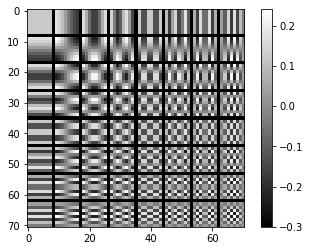

In [5]:
I = -0.3*np.ones((8*8+7,8*8+7))

for r in range(0,8):
    for c in range(0,8):
        block = np.zeros((8,8))
        block[r,c] = 1
        I[(r*8+r):(r*8+r)+8,(c*8+c):(c*8+c)+8] = idct2(block)

plt.imshow(I,cmap='gray')
plt.colorbar()
plt.show()

The above code produces the 2D-DCT basis function of frequency opposed to the DFT, the basis of DCT are real cosine signals of increasing frequency, thus when inversed, produce what it started off of basis.

## 1) Importing and preprocessing an image 

In this part I will load an image and preprocess it.

The code below does the following:
- input an image to the notebook. 
- convert the image from an RGB (3 color channel image of size $M \times N \times 3$) to grayscale (image of size $M \times N$).
- resize the image to $512 \times 512$. 
- plot your image in grayscale and include a colorbar.

You can use functions from numpy, scipy and skimage that were loaded in the preamble in part 0).

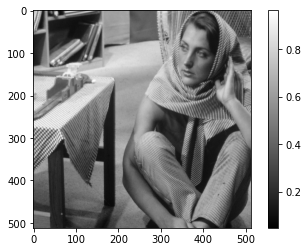

In [31]:
# read an image file

barbara = plt.imread('barbara.png').astype('float')

# convert image to grayscale

plt.imshow(barbara, cmap='gray')

# resize image to 512 times 512

barbara = resize(barbara, (512, 512))

# plot image

plt.colorbar()
plt.show()

# 2) Blockwise DCT transform

The JPEG compression algorithm is based on dividing the image up into blocks (or image patches).  
The function dct_block_image will:
- break up the image into 2D disjoint patches of $8 \times 8$. 
- apply the ```dct2``` function defined above to each patch. 
- The output is an $M \times N$ image where each block has been transform into DCT coefficients.  

Note the patches are disjoint and do not overlap. The upper-left coordinates of the patches are $(0,0),(0,8),(0,16),...,(8,0),(8,8),...(16,0),(16,8),...,(M-8,N-8)$.

In [36]:
from numpy import r_

def dct_block_image(image):
    # verify image height and width are multiples of 8
    height, width = np.array(image).shape
    if (height % 8 != 0) or (width % 8 != 0):
        return 'The height and width of the image are not multiples of 8.'
    image_size = image.shape
    dct = np.zeros(image_size)

    # DCT on block
    for i in r_[:image_size[0]:8]:
        for j in r_[:image_size[1]:8]:
            dct[i:(i+8),j:(j+8)] = dct2( image[i:(i+8),j:(j+8)] )
    return dct

Plot:
- an $8 \times 8$ block from the original image 
- the DCT applied to that block.  (Note you may want to control the ```vmax``` input value in ```imshow``` or apply a log transform in order to see a better range of valeus of the image)

Text(0.5, 1.0, 'DCT Block')

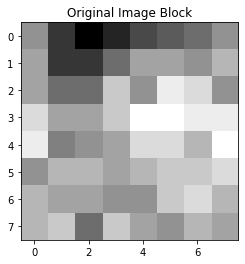

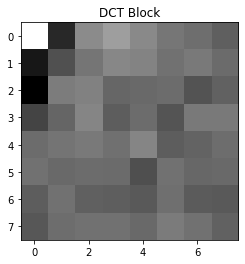

In [45]:

# the top left corner of the image block
r = 128
c = 128

dct_img = dct_block_image(barbara)

# plot the block from image

plt.figure()
plt.imshow(barbara[r:r+8,c:c+8],cmap='gray')
plt.title( "Original Image Block")
# plot the dct of that block
plt.figure()
plt.imshow(dct_img[r:r+8,c:c+8],cmap='gray',vmax= np.max(dct)*0.01)
plt.title( "DCT Block")

Note the top-left corner element (coefficient of $(u=0,v=0)$ basis function) has large magnitude. This is the DC coefficient (also called the constant component), which defines the mean value for the entire block. The remaining 63 coefficients are the AC coefficients (also called the alternating components).  
The advantage of the DCT is its tendency to aggregate most of the signal in the top left corner (or low frequency coefficients), as may be seen above. 

Full DCT block image ```dct_img```.

Text(0.5, 1.0, 'DCT Image')

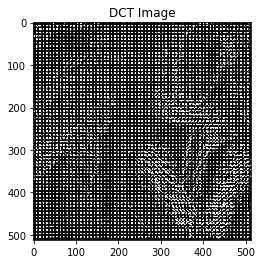

In [48]:
# plot full DCT-block image

dct_img = dct_block_image(barbara)

plt.figure()
plt.imshow(dct_img,cmap='gray',vmax = np.max(dct_img)*0.01,vmin = 0)
plt.title( "DCT Image")

# 3) Compression workflow and evaluation metrics
We will compare two methods of compressing the image using the DCT.   
Both compression frameworks are based on the following workflow. First the image is transformed to a block-DCT image. Then some of the coefficients are zeroed out based on a thresholding scheme. Compression takes place by only the non-zero values being stored. Thus we measure the level of compression by the **percentage of non-zero values** (number of non-zeros divided by total number of pixels). Upon receiving the thresholded block-DCT image, an inverse block-DCT is applied and we obtain the compressed image.  

A good compression algorithm outputs an image that is as similar as possible to the original image, but requires much less elements to store.  
Therefore to evaulte the compression scheme, we will measure image quality using the **mean square error**:
$$ MSE = \frac{1}{MN} \sum_m \sum_n (I[m,n]-I_\textrm{compressed}[m,n])^2$$  
Note that other measures exist to quantify the quality of an image, some of which are tuned to human visual perception. 

# 4) Compression - global thresholding
For the first framework we will aplly a global threshold to the DCT-block transformed image.  

The two functions below:
- takes as input the DCT block image and a threshold value $\tau$. The function will zero out all DCT coefficients that are below $\tau$ times the **maximum absolute value** of the full DCT block image. The function will output the thresholded image and the percentage of non-zero values in the thresholded image.
- takes as input an image, breaks it up into 2D patches of size $8 \times 8$ and applies the inverse DCT transform (```idct2``` function defined above) to each patch. The output is an $M \times N$ image where each block has been transformed back into the spatial domain.  

In [67]:
def threshold_image(dct_image,tau = 0.1):
    # remeber to return two output variables
    height, width = dct_image.shape
    dct_filtered = dct_image * (np.abs(dct_image) > (tau * np.max(dct_image)))
    pct_nonzero = np.count_nonzero(dct_filtered) / (height * width) * 100
    return dct_filtered, pct_nonzero

In [68]:
def inverse_dct_block_image(dct_image):

    # verify image height and width are multiples of 8
    height, width = dct_image.shape
    if (height % 8 != 0) or (width % 8 != 0):
        return 'The height and width of the image are not multiples of 8.'
    
    inv_dct = np.zeros(dct_image.shape)

    for i in r_[:dct_image.shape[0]:8]:
        for j in r_[:dct_image.shape[1]:8]:
            inv_dct[i:(i+8),j:(j+8)] = idct2(dct_image[i:(i+8),j:(j+8)])
    return inv_dct

Now apply the thresholding function with $\tau=0.1$ to the DCT-block transform image and invert it back to the spatial domain. 
Then plot 
- the original image
- the image after global thresholding  
- the difference image between the two, where the difference image is the **absolute value** of the difference between the two images

In [72]:
# applying thresholding and invert block-DCT

dct_img = dct_block_image(barbara)
img_filt, percent_nonzero = threshold_image(dct_img, tau=0.1)
rec_img = inverse_dct_block_image(img_filt)
print(percent_nonzero)

1.7971038818359375


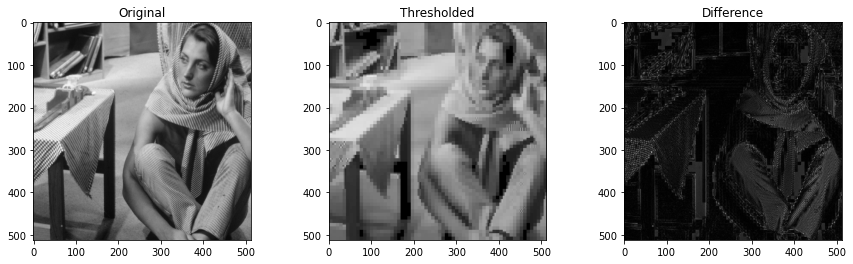

In [79]:
# plot images
plt.figure(figsize=(15, 4))
plt.subplot(1, 3, 1)
plt.title('Original')
plt.imshow(barbara, cmap='gray')

plt.subplot(1, 3, 2)
plt.title('Thresholded')
plt.imshow(rec_img, cmap='gray')

plt.subplot(1, 3, 3)
plt.title('Difference')
plt.imshow(np.abs(barbara - rec_img), cmap='gray')


The compressed image is much more pixelized than the original image. It has lost its darker colors and so the compressed image has become very much lighter in grayscale. The compressed image has also lost its sharp edges as it thresholded the pixel values.

# 5) Evaluation
In the compression algorithm you implemented, the threshold controls the compression rate as it implicitly determines the number of non-zeros retained in the image.  We want to evaluate how distorted the image is after compression.
We will use MSE between the image after compression and the original image as a quality measure.

In the block below I will loop over a range of threshold values.
For each threshold value
- apply the thresholding function and the block inverse-DCT
- store in an array the percentage of non-zeros values that remained after thresholding
- store in an array the mean squared error (MSE) between the original iamge and the compressed image
- Plot 3 subplots of the original image, the image after global thresholding and the difference image between the two.



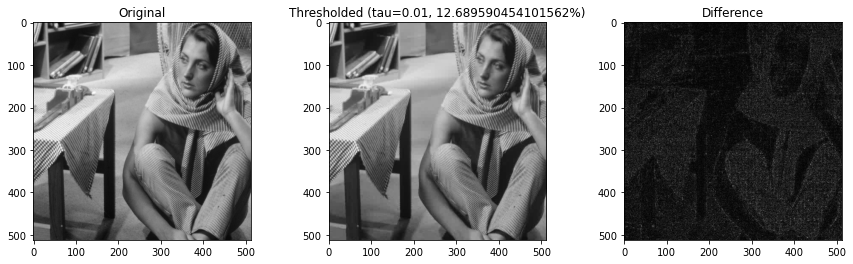

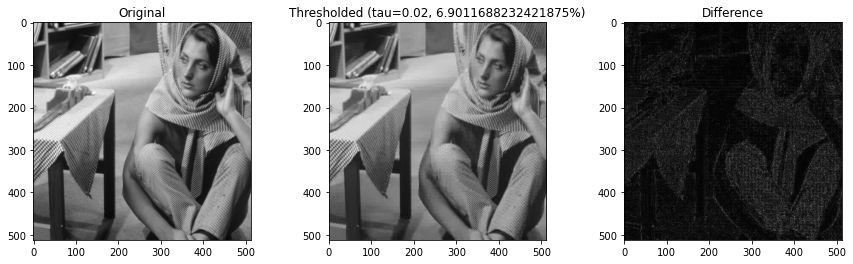

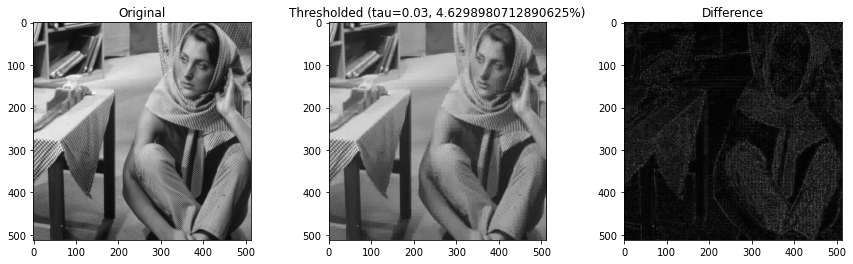

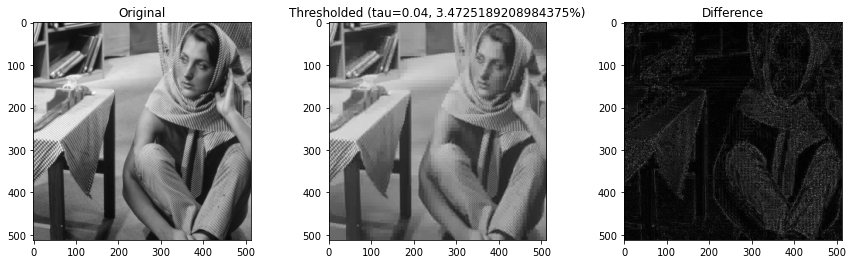

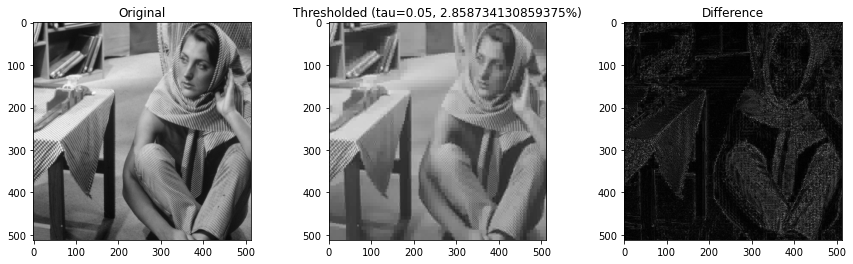

...

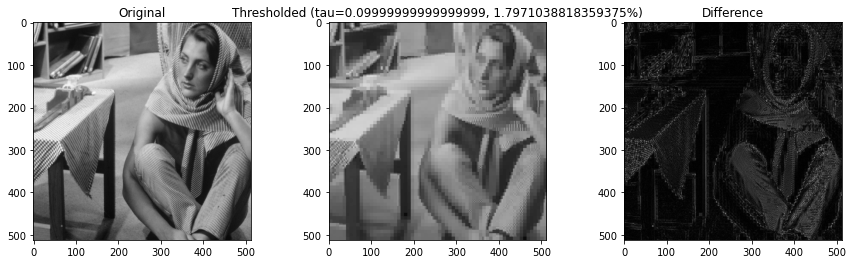

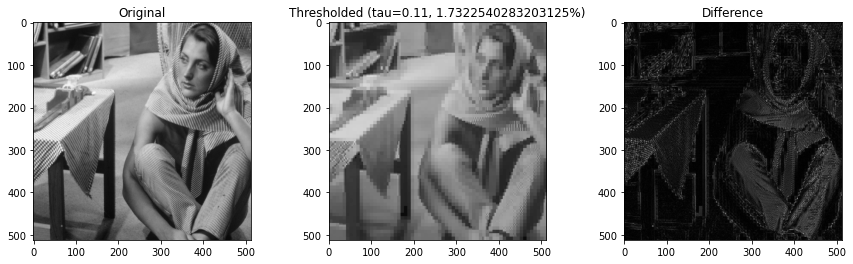

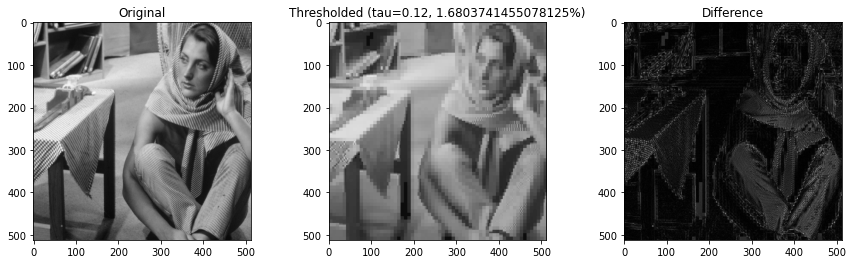

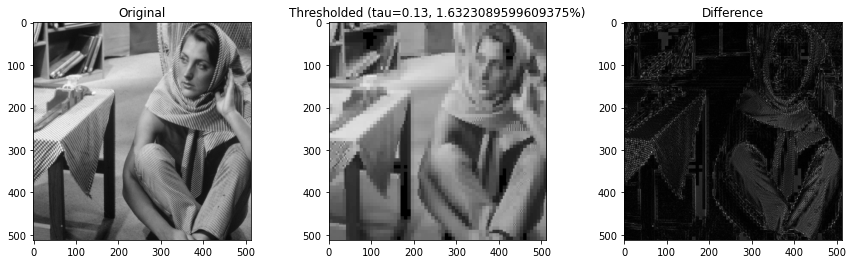

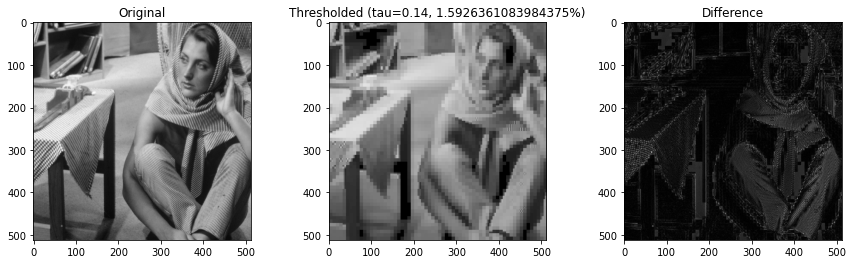

In [107]:
thresholds = np.arange(0.01,0.15,0.01)

# create output arrays for percentage of non-zeros and MSE

percents = np.array([])
mse = np.array([])

# loop over thresholds

for threshold in thresholds:

    dct_img = dct_block_image(barbara)
    img_filt, percent_nonzero = threshold_image(dct_img, tau=threshold)
    rec_img = inverse_dct_block_image(img_filt)

    percents = np.append(percents, percent_nonzero)
    mse = np.append(mse, (np.square(barbara - rec_img)).mean())

    plt.figure(figsize=(15, 4))
    
    plt.subplot(1, 3, 1)
    plt.title('Original')
    plt.imshow(barbara, cmap='gray')

    plt.subplot(1, 3, 2)
    plt.title('Thresholded (tau=' + str(threshold) + ', ' + str(percent_nonzero) + '%)')
    plt.imshow(rec_img, cmap='gray')
    
    plt.subplot(1, 3, 3)
    plt.title('Difference')
    plt.imshow(np.abs(barbara - rec_img), cmap='gray')

As the threshold increases, the compressed image preserves less percentage of the original pixels, making the image more pixelized or blurry and lose its sharp edges. The features most affected by the compression is the percentage of nonzero coefficients and the difference between the compressed image and the original image.

Below are plots of: 
- thresholds vs MSE
- thresholds vs percentage of non-zeros
- percentage of non-zeros vs MSE

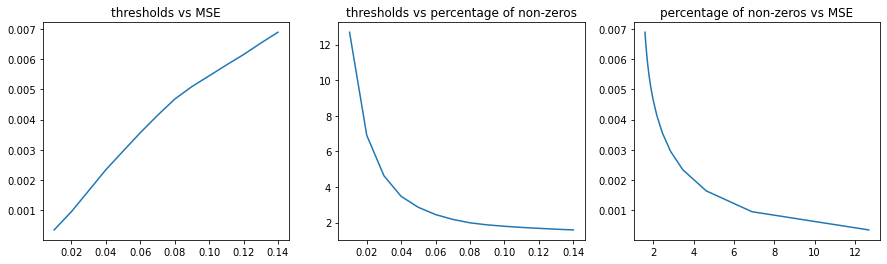

In [82]:
# 3 plots

plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
plt.title('thresholds vs MSE')
plt.plot(thresholds, mse)

plt.subplot(1, 3, 2)
plt.title('thresholds vs percentage of non-zeros')
plt.plot(thresholds, percents)

plt.subplot(1, 3, 3)
plt.title('percentage of non-zeros vs MSE')
plt.plot(percents, mse)

We can notice that as the threshold increases, the quality of the thresholded image decreases, becoming more pixelized. As the threshold increases, it can be noticed that the mean squared error between the values of the original image and the thresholded image increases quite linearly. However, as the threshold increases, the percentage of non-zeros decreases exponentially, keeping less of the values from the original iamge. The relationship getween the mean squared error and the number of non-zeros decreases exponentially as well. The more values from the original image the thresholded image keeps, the lower the mean squared error is, which is very much self explanatory: more similar to the original image, the less difference there is between the original image and the filtered image.

# 6) Local block - based compression

Now we will implement a block based compression approach.
Below is a function that takes as input the DCT-block image and $k$ - number of non-zero values to retain in each block (what are the minimum and maximum possible values of $k$?).   
The function will loop over the $8 \times 8$ blocks and for each block keep only the $k$ elements with highest **absolute value**.  
The function will output the DCT-block image after block thresholding and the percentage of non-zero values in the thresholded image (hint: this value depends on $k$).

In [92]:
def dct_block_threshold(dct_image, k=7):
    # verify image height and width are multiples of 8
    height, width = dct_image.shape
    if (height % 8 != 0) or (width % 8 != 0):
        return 'The height and width of the image are not multiples of 8.'
    
    thr_dct = np.zeros(dct_image.shape)

    for i in r_[:dct_image.shape[0]:8]:
        for j in r_[:dct_image.shape[1]:8]:
            patch = dct_image[i:(i+8),j:(j+8)]
            patch_sorted = np.sort(np.abs(patch.flatten()))[::-1]
            k_biggest = patch_sorted[:k]
            filt = np.isin(np.abs(patch), k_biggest)
            thr_dct[i:(i+8),j:(j+8)] = patch * filt

    pct_nonzero = np.count_nonzero(thr_dct) / (height * width) * 100

    return thr_dct, pct_nonzero

Now apply the block thresholding function with $k=7$ to the DCT-block transform image and invert it back to the spatial domain. 
Plot 
- the original image
- the image after local compression 
- the difference image between the two, where the difference image is the absolute value of the difference between the two images

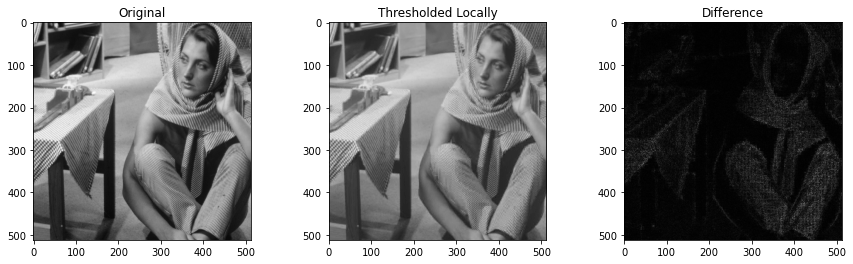

In [95]:
dct_img = dct_block_image(barbara)
img_filt, percent_nonzero = dct_block_threshold(dct_img, k=7)
rec_img_local = inverse_dct_block_image(img_filt)

# plot images
plt.figure(figsize=(15, 4))
plt.subplot(1, 3, 1)
plt.title('Original')
plt.imshow(barbara, cmap='gray')

plt.subplot(1, 3, 2)
plt.title('Thresholded Locally')
plt.imshow(rec_img_local, cmap='gray')

plt.subplot(1, 3, 3)
plt.title('Difference')
plt.imshow(np.abs(barbara - rec_img_local), cmap='gray')

In the block below I will loop over a range of $k$ values to retain in each block.
For each $k$ value
- apply the block thresholding function and the block inverse-DCT function 
- store in an array the percentage of non-zeros values that remained after thresholding
- store in an array the mean squared error (MSE) between the original iamge and the compressed image
- Plot 3 subplots of the original image, the image after local compression and the difference image between the two.



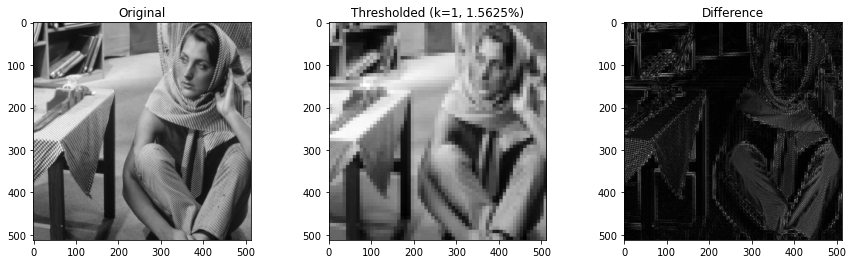

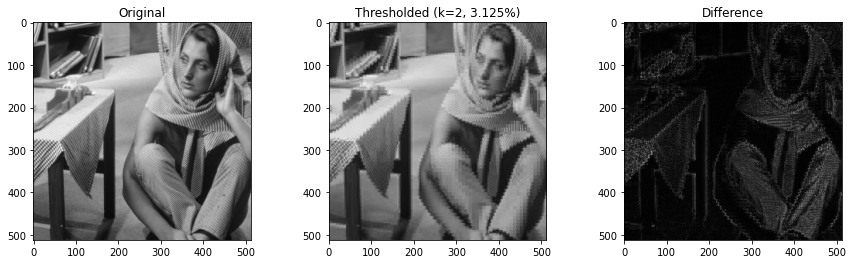

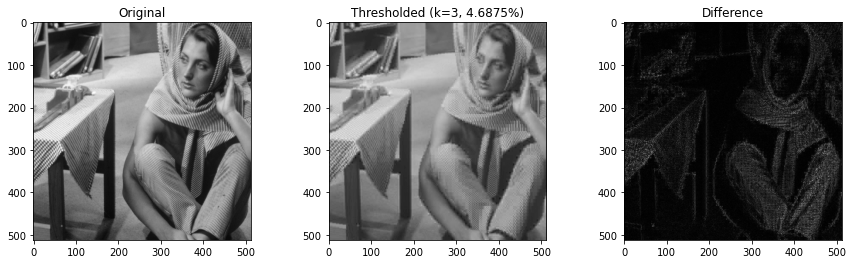

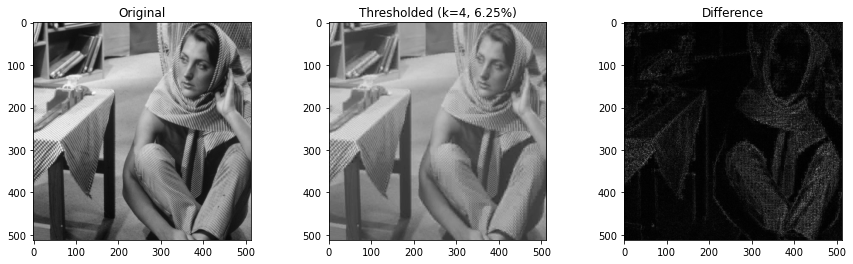

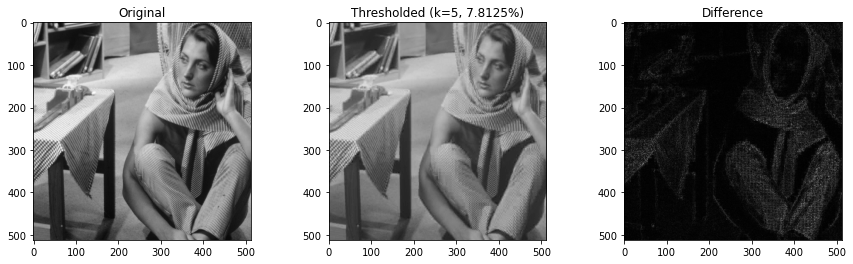

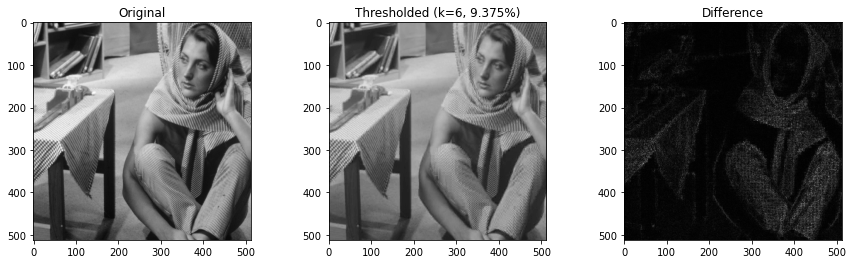

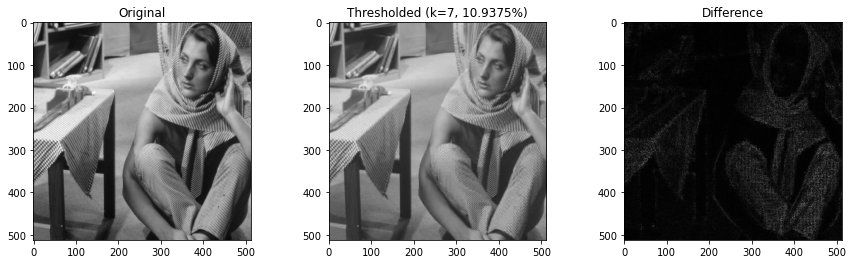

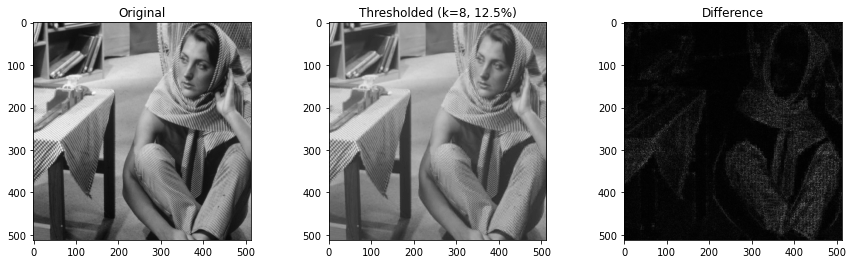

In [105]:
k_vals = np.arange(1,9) # number of non-zeros to retain in each block

# create output arrays for percentage of non-zeros and MSE

percents_local = np.array([])
mse_local = np.array([])

# loop over thresholds

for k in k_vals:

    dct_img = dct_block_image(barbara)
    img_filt, percent_nonzero = dct_block_threshold(dct_img, k)
    rec_img = inverse_dct_block_image(img_filt)

    percents_local = np.append(percents_local, percent_nonzero)
    mse_local = np.append(mse_local, (np.square(barbara - rec_img)).mean())

    plt.figure(figsize=(15, 4))
    
    plt.subplot(1, 3, 1)
    plt.title('Original')
    plt.imshow(barbara, cmap='gray')

    plt.subplot(1, 3, 2)
    plt.title('Thresholded (k=' + str(k) + ', ' + str(percent_nonzero) + '%)')
    plt.imshow(rec_img, cmap='gray')
    
    plt.subplot(1, 3, 3)
    plt.title('Difference')
    plt.imshow(np.abs(barbara - rec_img), cmap='gray')

# 7) Method comparison 
Plot of the percentage of non-zeros vs MSE for both global and local thresholding

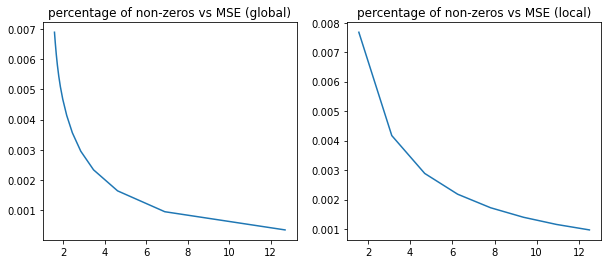

In [109]:
plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.title('percentage of non-zeros vs MSE (global)')
plt.plot(percents, mse)

plt.subplot(1, 2, 2)
plt.title('percentage of non-zeros vs MSE (local)')
plt.plot(percents_local, mse_local)

 From the two graphs above, we can notice that even though both methods decrease the mean squared error as the percentage of non-zero values increases, when we perform global thresholding of DCT images, we get smaller mean sqaured errors for the same percentage of non-zero values. For exmaple if we look at when percentage of non-zero values is 4, the mean squared error of global thresholding is approximately 0.002, whereas mean squared error of local thresholding is above 0.003, indicating worse image quality.

## 8) Comparison to Haar wavelets

In the block below, compute the Haar decomposition of the image.  We will use this to compare the thresholding to block DCT.  In the following block, compute the full 2D Haar decomposition and threshold the coefficients at varying levels similar to Section 5.  Recreate the non-zeros vs. MSE plot as in Section 7, adding the Haar curve to the two that already existed.

<ipython-input-129-32ccfb6d8416>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15, 4))


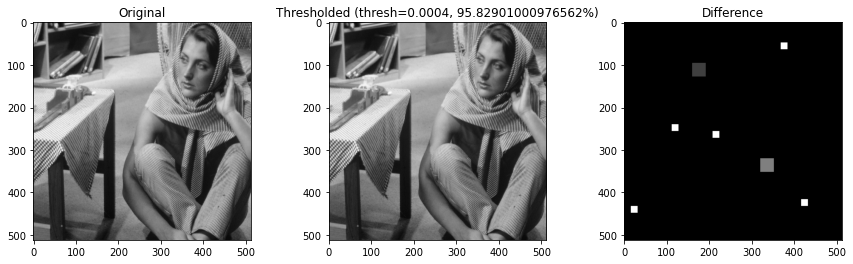

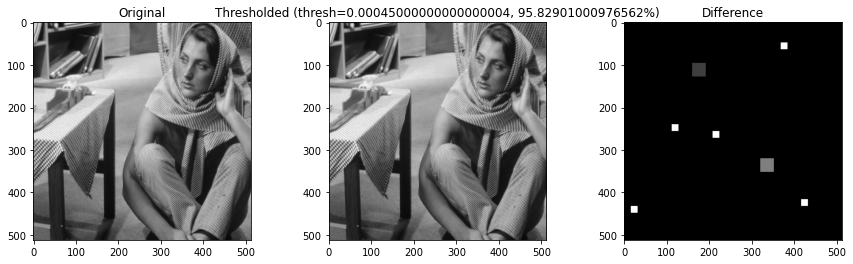

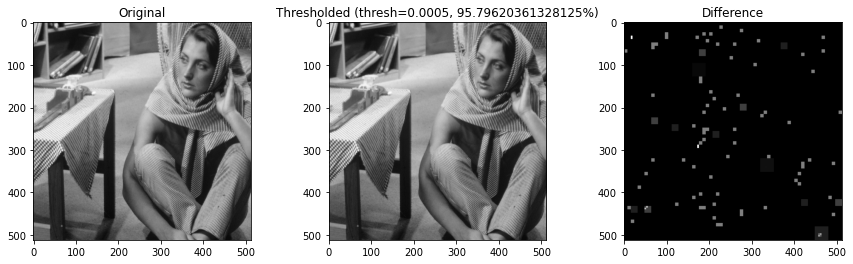

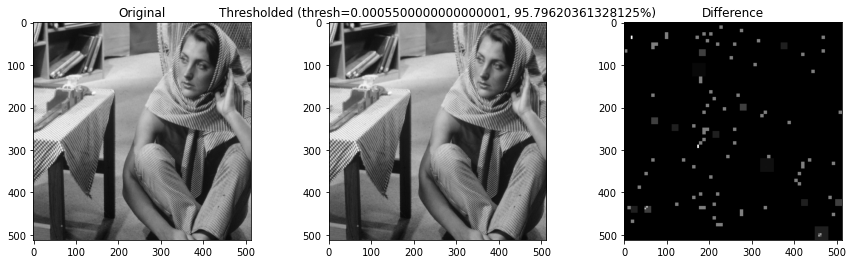

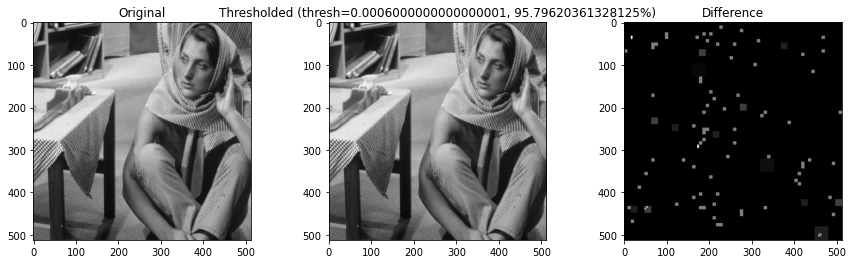

...

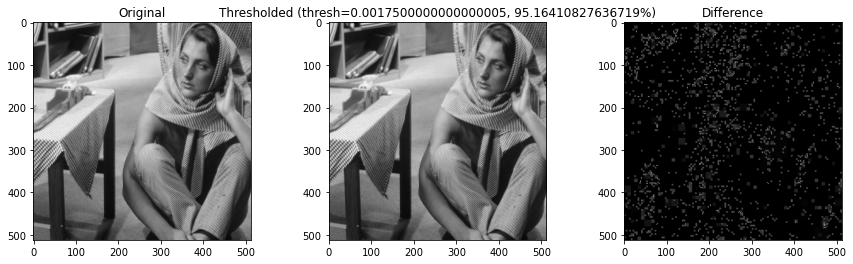

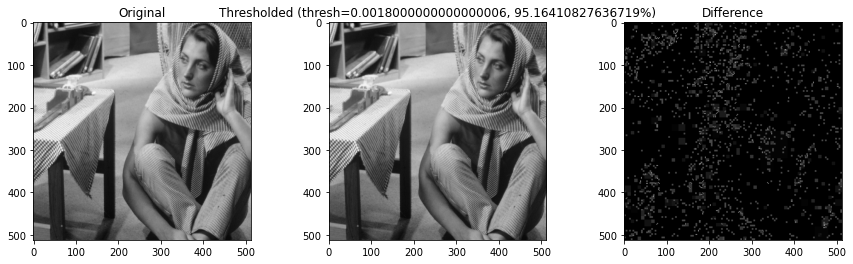

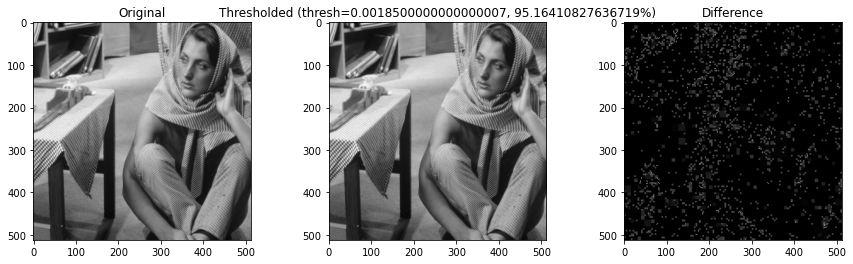

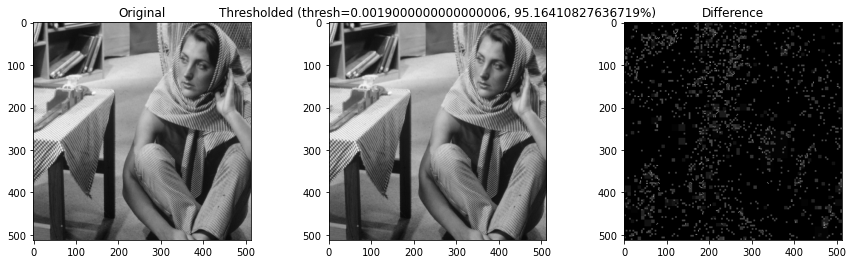

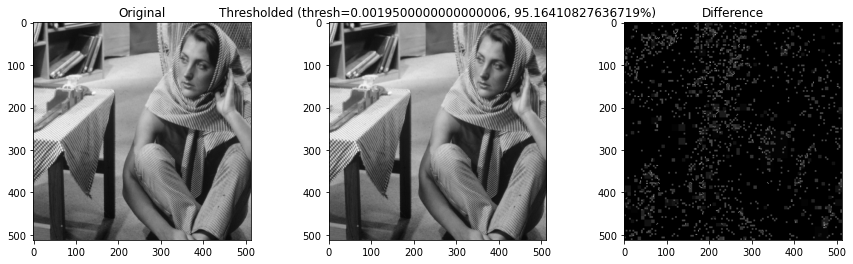

In [129]:
thresholdsHaar = np.arange(4e-4,2e-3,5e-5)

# create output arrays for percentage of non-zeros and MSE

percents_haar = np.array([])
mse_haar = np.array([])

# loop over threshold

height, width = barbara.shape

for threshold_haar in thresholdsHaar:
    coeffs = pywt.wavedec2(barbara, 'haar')

    # Turn into array and back
    arr, coeff_slices = pywt.coeffs_to_array(coeffs)
    
    arr_vec = arr.reshape(height*width)
    # threshold = mult * np.mean(np.abs(arr_vec))
    arr_vec[np.abs(arr_vec) < threshold_haar] = 0
    
    arr_reconstruct = arr_vec.reshape(height, width)

    fracNonZero = np.count_nonzero(arr_reconstruct)/(height * width) * 100

    coeffs_reconstruct = pywt.array_to_coeffs(arr_reconstruct, coeff_slices, output_format = 'wavedec2')
    reconstructed = pywt.waverec2(coeffs_reconstruct, 'haar')

    percents_haar = np.append(percents_haar, fracNonZero)
    mse_haar = np.append(mse_haar, (np.square(barbara - reconstructed)).mean())

    plt.figure(figsize=(15, 4))
    
    plt.subplot(1, 3, 1)
    plt.title('Original')
    plt.imshow(barbara, cmap='gray')

    plt.subplot(1, 3, 2)
    plt.title('Thresholded (thresh=' + str(threshold_haar) + ', ' + str(fracNonZero) + '%)')
    plt.imshow(reconstructed, cmap='gray')
    
    plt.subplot(1, 3, 3)
    plt.title('Difference')
    plt.imshow(np.abs(barbara - reconstructed), cmap='gray')

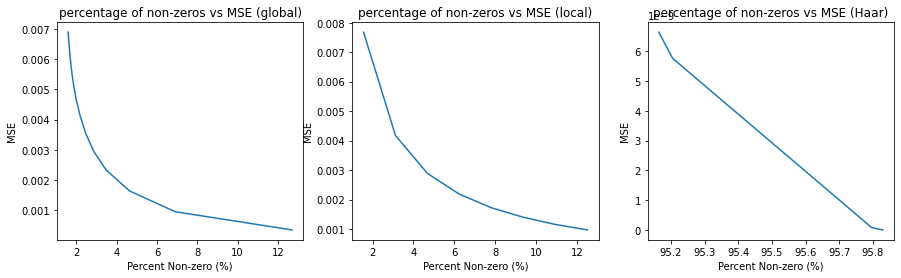

In [135]:
# 1 plot
plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
plt.title('percentage of non-zeros vs MSE (global)')
plt.xlabel('Percent Non-zero (%)')
plt.ylabel('MSE')
plt.plot(percents, mse)

plt.subplot(1, 3, 2)
plt.title('percentage of non-zeros vs MSE (local)')
plt.xlabel('Percent Non-zero (%)')
plt.ylabel('MSE')
plt.plot(percents_local, mse_local)

plt.subplot(1, 3, 3)
plt.title('percentage of non-zeros vs MSE (Haar)')
plt.xlabel('Percent Non-zero (%)')
plt.ylabel('MSE')
plt.plot(percents_haar, mse_haar)

We would be down to the 6th level of decomposition. At each level, the Haar wavelet transforms our 512 x 512 image to four 256 x 256. The next level does it to sixteen 128 x 128 partitions. In this sense, when we get to the 6th column, our paritions will be of size 8 x 8.